In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from IPython.display import HTML
import matplotlib.animation as animation

<>:36: SyntaxWarning: invalid escape sequence '\P'
<>:36: SyntaxWarning: invalid escape sequence '\P'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_32385/2780193756.py:36: SyntaxWarning: invalid escape sequence '\P'
  plt.ylabel('$\Psi$(x, t) (Amplitude)',size = 14)
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_32385/2780193756.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('coolwarm', M//20)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


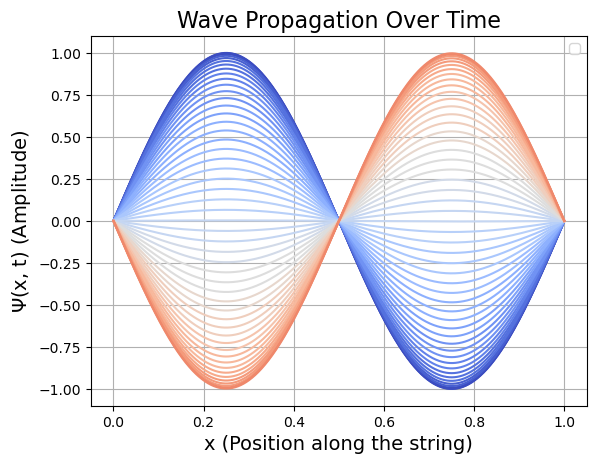

In [2]:
L = 1
N = 1000  
dx = L / (N - 1)
c = 1
dt = 0.001  
T = 0.5
M = int(T / dt)

x = np.linspace(0, L, N)
t = np.linspace(0, T, M)
u = np.zeros((N, M))

# Initial conditions
u[:, 0] = np.sin(2 * np.pi * x)
#u[:, 0] = np.sin(5 * np.pi * x)  # Condition (ii)
#u[:, 0] = np.where((x > 1/5) & (x < 2/5), np.sin(5 * np.pi * x), 0)


u[0, :] = 0
u[-1, :] = 0

for i in range(1, N-1):
    u[i, 1] = u[i, 0]

for j in range(1,M-1):
    for i in range(1,N-1):
        u[i,j+1]= c**2 * (dt**2/dx**2) * (u[i+1,j] + u[i-1,j] - 2* u[i,j]) - u[i,j-1] + 2*u[i,j]

# Every 20th timestep
cmap = cm.get_cmap('coolwarm', M//20)

for j in range(0, M, 10): 
    plt.plot(x, u[:, j],color=cmap(j // (M//20)))

plt.xlabel('x (Position along the string)',size = 14)
plt.ylabel('$\Psi$(x, t) (Amplitude)',size = 14)
plt.title('Wave Propagation Over Time',size = 16)
plt.legend()
plt.grid()
plt.savefig("Wavepropegation_i.png", dpi=300)
plt.show()

<>:7: SyntaxWarning: invalid escape sequence '\P'
<>:7: SyntaxWarning: invalid escape sequence '\P'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_32385/1112197271.py:7: SyntaxWarning: invalid escape sequence '\P'
  ax.set_ylabel('$\Psi$(x, t) (Amplitude)')
Animation size has reached 20984536 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


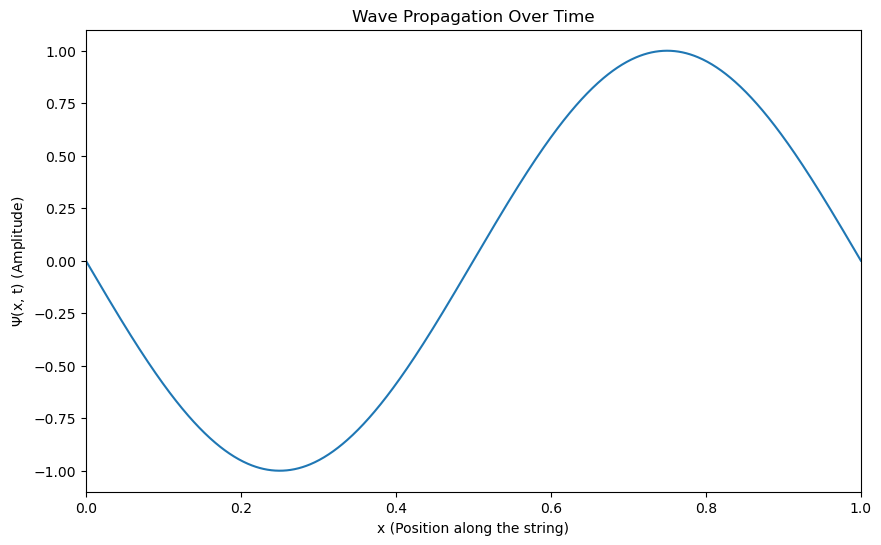

In [3]:
fig, ax = plt.subplots(figsize=(10, 6))
line, = ax.plot([], []) 

ax.set_xlim(0, L)
ax.set_ylim(-1.1, 1.1)
ax.set_xlabel('x (Position along the string)')
ax.set_ylabel('$\Psi$(x, t) (Amplitude)')
ax.set_title('Wave Propagation Over Time')

def update(frame):
    line.set_data(x, u[:, frame]) 
    return line,

ani = animation.FuncAnimation(fig, update, frames=M, interval=20, blit=True)
HTML(ani.to_jshtml())

### Question H 
H. (1 point) Implement the Jacobi iteration, the Gauss-Seidel method and SOR.
Try N = 50. Test the methods by comparing the result to the analytical result in
eq. (5), i.e. the linear dependence of the concentration on y


the jacobi iteration updates the concentration at each grid point based on the average of its four neighboring points. Iterate repeatedly until the solution stabilizes (i.e., the change between iterations is very small)

\textbf{Initialization:}

Set up an array $c_{current}[i, j]$ for the current iteration.  
Set up another array $c_{next}[i, j]$ for the next iteration.  
Apply boundary conditions immediately:  

\begin{equation}  
c[:, 0] = 0, \quad c[:, -1] = 1, \quad \text{periodic in } x  
\end{equation}  

Initial guess: Set the interior points to $0$ or some arbitrary value.  


For every point $(i, j)$ excluding boundaries, compute the new value using the formula:

\begin{equation}  
c\_next[i, j] = \frac{1}{4} \left( c\_current[i+1, j] + c\_current[i-1, j] + c\_current[i, j+1] + c\_current[i, j-1] \right)  
\end{equation}  

Do not update the values in $c_{current}$ immediately. Instead, store them in $c_{next}$.  
This is crucial because if you overwrite $c_{current}$ directly, you will lose information needed for the remaining calculations in this iteration.


Jacobi Iteration Converged in 1827 iterations


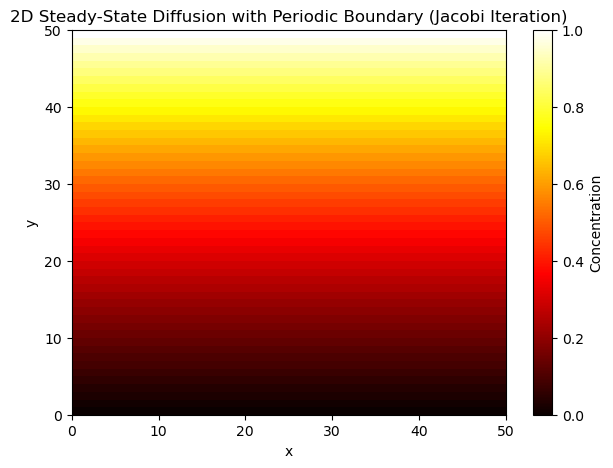

In [4]:
def Jacobi_Iteration(epsilon, N=50, max_iter=10000):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    # Boundary Conditions
    c_current[-1, :] = 0
    c_current[0, :] = 1
    c_next[:, 0] = c_next[:, 1]
    c_next[:, -1] = c_next[:, -2]

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()

        for i in range(1, N-1):
            for j in range(1, N-1):
                c_next[i, j] = (1/4) * (c_current[(i+1) % N, j] +c_current[(i-1) % N, j] +c_current[i, j+1] + c_current[i, j-1])

        c_next[-1, :] = 0
        c_next[0, :] = 1
        c_next[:, 0] = c_next[:, 1]
        c_next[:, -1] = c_next[:, -2]

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return c_next, iteration 

        c_current[:, :] = c_next[:, :]
        iteration += 1

    return c_current, iteration
N = 50
epsilon = 10e-5
c_jacobi, i_jacobi = Jacobi_Iteration(epsilon, N)
c_jacobi_center = c_jacobi[:, N//2] 

print(f"Jacobi Iteration Converged in {i_jacobi} iterations")
plt.figure(figsize=(7, 5))
plt.imshow(c_jacobi, cmap='hot', aspect='auto', extent=[0, N, 0, N])
plt.colorbar(label='Concentration')
plt.title('2D Steady-State Diffusion with Periodic Boundary (Jacobi Iteration)')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Gauss-Seidel Converged in 1261 iterations


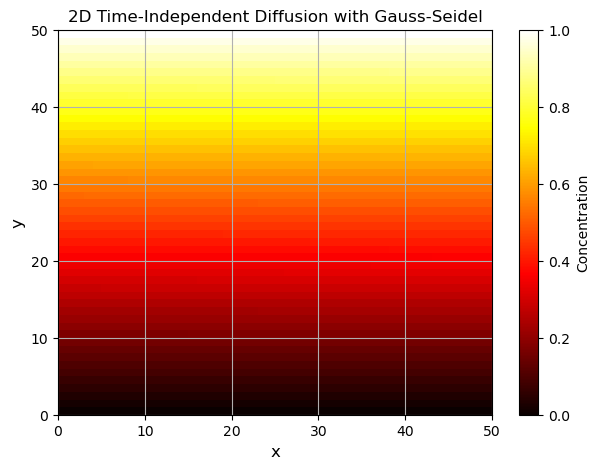

In [5]:
max_iter=10000
def Gauss_Seidel(epsilon, N=50):

    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1
    c_current[:, 0] = c_current[:, 1]  
    c_current[:, -1] = c_current[:, -2]

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()

        for i in range(1, N-1):
            for j in range(1, N-1):
                c_next[i, j] = (1/4) * (c_current[(i+1) % N, j] + c_next[(i-1) % N, j] +c_current[i, j+1] + c_next[i, j-1])
        c_next[0, :] = 1  
        c_next[-1, :] = 0
        c_next[:, 0] = c_next[:, 1]
        c_next[:, -1] = c_next[:, -2]

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return c_next, iteration
        c_current[:, :] = c_next[:, :]
        iteration += 1

    return c_current, iteration

N = 50
epsilon = 10e-5
c_gauss, i_gauss = Gauss_Seidel(epsilon, N)
c_gauss_center = c_gauss[:, N//2] 

print(f"Gauss-Seidel Converged in {i_gauss} iterations")
plt.figure(figsize=(7, 5))
plt.imshow(c_gauss, cmap='hot', aspect='auto', extent=[0, N, 0, N])
plt.colorbar(label='Concentration')
plt.title('2D Time-Independent Diffusion with Gauss-Seidel')
plt.xlabel('x', size=12)
plt.ylabel('y', size=12)
plt.grid(True)
plt.savefig("Gauss_Seidel_heatmap.png", dpi=300)
plt.show()

In [6]:
N = 50
max_iter = 10000
epsilon_list = [1e-3,1e-4, 1e-5,1e-6] 
w_list =  [1,1.5,1.95] 

def SOR(w, epsilon):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1
    c_next[:, 0] = c_next[:, 1]
    c_next[:, -1] = c_next[:, -2]

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                
                c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1
        c_next[:, 0] = c_next[:, 1]
        c_next[:, -1] = c_next[:, -2]

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            #print(f"Converged after {iteration} iterations with delta = {delta}")
            return c_next, iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return c_next,iteration

iterations_matrix = np.zeros((len(epsilon_list), len(w_list)))
for e_idx, e in enumerate(epsilon_list):
    for w_idx, w in enumerate(w_list):
        _,i = SOR(w, e)
        iterations_matrix[e_idx, w_idx] = i
    
iterations_gauss = np.zeros(len(epsilon_list))
iterations_jacobi = np.zeros(len(epsilon_list))

for e_idx, e in enumerate(epsilon_list):
    _, i = Gauss_Seidel(e)
    iterations_gauss[e_idx] = i

for e_idx, e in enumerate(epsilon_list):
    _, i = Jacobi_Iteration(e)
    iterations_jacobi[e_idx] = i

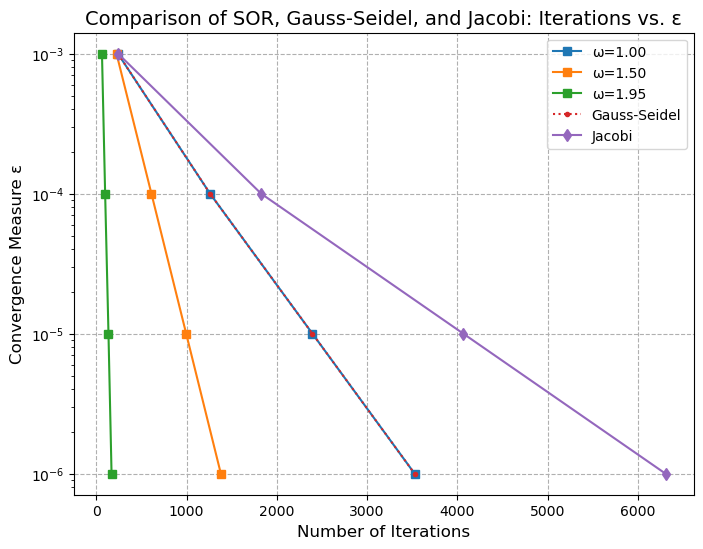

In [7]:
plt.figure(figsize=(8, 6))
for w_idx, w in enumerate(w_list):
    plt.plot( iterations_matrix[:, w_idx], epsilon_list,
        marker='s', 
        label=f'ω={w:.2f}'
    )

plt.plot(iterations_gauss, epsilon_list, marker='.', linestyle=":", label="Gauss-Seidel",alpha = 1)
plt.plot(iterations_jacobi, epsilon_list, marker='d', linestyle="-", label="Jacobi")

plt.yscale('log') 
#plt.xscale('log')
plt.ylabel('Convergence Measure ε', size=12)
plt.xlabel('Number of Iterations', size=12)
plt.title('Comparison of SOR, Gauss-Seidel, and Jacobi: Iterations vs. ε', size=14)
plt.legend()
plt.grid(True, linestyle='--')
plt.savefig("Method_Comparison_Iterations_vs_Epsilon.png", dpi=300)
plt.show()
c_,i_ = SOR(1.9, 1e-5)
c_sor_center = c_[:, N//2]

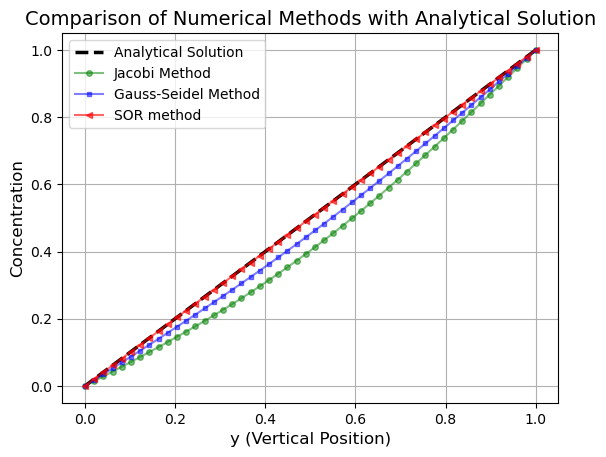

In [8]:
y = np.linspace(1,0, N)
c_analytical = y 

plt.plot(y, c_analytical, 'k--', linewidth=2.5, label="Analytical Solution")
plt.plot(y, c_jacobi_center, 'g-', marker='o', markersize=4,alpha = 0.5, label="Jacobi Method")
plt.plot(y, c_gauss_center, 'b-', marker='s', markersize=3,alpha = 0.5, label="Gauss-Seidel Method")
plt.plot(y, c_sor_center , 'r-', marker='<',markersize=4,alpha = 0.6, label="SOR method")
plt.legend()

plt.xlabel('y (Vertical Position)', size=12)
plt.ylabel('Concentration', size=12)
plt.title('Comparison of Numerical Methods with Analytical Solution', size=14)

plt.legend()
plt.grid()
plt.savefig("Comparison_Numerical_Methods.png", dpi=300)
plt.show()

N=50: Min Iterations = 97.0, at ω = 1.94
N=75: Min Iterations = 141.0, at ω = 1.96
N=100: Min Iterations = 182.0, at ω = 1.97


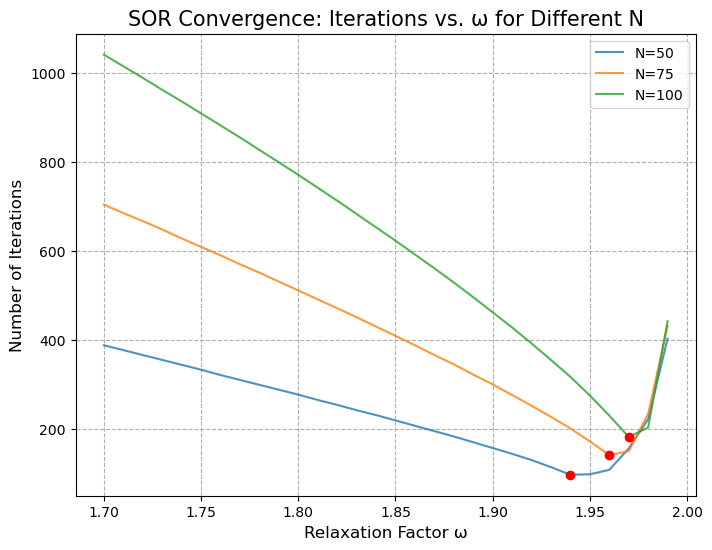

In [9]:
N_list = [50,75,100]
max_iter = 10000
epsilon_list = [1e-5] 
w_list = np.linspace(1.7,1.99,30)

def SOR(w, epsilon,N):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1
    c_next[:, 0] = c_next[:, 1]
    c_next[:, -1] = c_next[:, -2]

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                
                c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1
        c_next[:, 0] = c_next[:, 1]
        c_next[:, -1] = c_next[:, -2]

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return iteration

iterations_matrix = np.zeros((len(N_list), len(w_list)))

for N_idx, N in enumerate(N_list):
    for w_idx, w in enumerate(w_list):
        i = SOR(w, epsilon, N)
        iterations_matrix[N_idx, w_idx] = i

plt.figure(figsize=(8, 6))

for N_idx, N in enumerate(N_list):
    plt.plot(
        w_list,
        iterations_matrix[N_idx, :],alpha = 0.8,
        label=f'N={N}'
    )
    min_index = np.argmin(iterations_matrix[N_idx, :])
    optimal_w = w_list[min_index]
    print(f'N={N}: Min Iterations = {iterations_matrix[N_idx, min_index]}, at ω = {optimal_w}')
    plt.plot(optimal_w,iterations_matrix[N_idx, min_index],'r',marker = 'o')

plt.xscale('linear')
#plt.yscale('log')  # Log scale for iterations
plt.xlabel('Relaxation Factor ω',size = 12)
plt.ylabel('Number of Iterations',size =12)
plt.title('SOR Convergence: Iterations vs. ω for Different N',size = 15)
plt.grid(True, which='both', linestyle='--')
plt.legend()
plt.savefig("SOR_convergence_optimalomega.png", dpi=300)
plt.show()

151


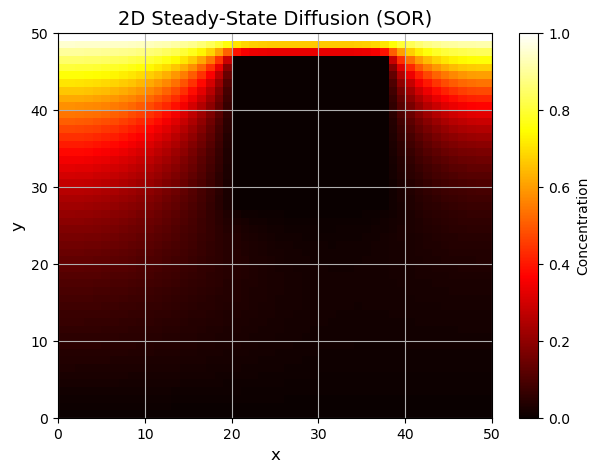

In [10]:
# list of points (i,j) that are part of object extra array of integers 1 for the object 
def object(N,size_rec, two_objects):
    grid = np.zeros((N,N))
    for i in range(size_rec):
        for j in range(size_rec -2):
            grid[i+ 3,j+20] = 1 
            if two_objects:
                grid[i+ 5,j+2] = 1
            
    return grid

N = 50
max_iter = 10000
epsilon = 1e-5
w = 1.85

def SOR_object(w, epsilon,N,number_objects,object_size):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1  

    iteration = 0
    grid = object(N,object_size,number_objects)
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                if grid[i,j]== 1:
                    c_next[i,j] == 0
                else:
                    c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1
        c_next[:, 0] = c_next[:, 1]
        c_next[:, -1] = c_next[:, -2]

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return c_current, iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return c_current, iteration

i_list = []
c, i = SOR_object(w,epsilon,N, False,20)
print(i)
plt.figure(figsize=(7,5))
plt.imshow(c,  cmap='hot', aspect='auto',extent=[0,50,0,50])
plt.colorbar(label='Concentration')
plt.title('2D Steady-State Diffusion (SOR)',size = 14)
plt.xlabel('x',size = 12)
plt.ylabel('y',size = 12)
plt.grid(True)
plt.savefig("SOR_heatmapbigobject.png", dpi=300)
plt.show()

i_list_smallobject = []
i_list_bigobject = []
i_list_2smallobjects = []
i_list_2bigobjects = []
i_noobject = []
w_list = np.linspace(1.7,1.98,40)
for w in w_list:
    c, i_small = SOR_object(w,epsilon,N,False,5)
    c, i_big = SOR_object(w,epsilon,N,False,20)
    c, i_2small = SOR_object(w,epsilon,N,True,5)
    c, i_2big = SOR_object(w,epsilon,N,True,20)
    c,i_no =SOR_object(w,epsilon,N,True,0)
    i_list_smallobject.append(i_small)
    i_list_bigobject.append(i_big)
    i_list_2smallobjects.append(i_2small)
    i_list_2bigobjects.append(i_2big)
    i_noobject.append(i_no)

<>:9: SyntaxWarning: invalid escape sequence '\o'
<>:9: SyntaxWarning: invalid escape sequence '\o'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_32385/2241505725.py:9: SyntaxWarning: invalid escape sequence '\o'
  plt.xlabel('Relax parameter $\omega$',size = 12)


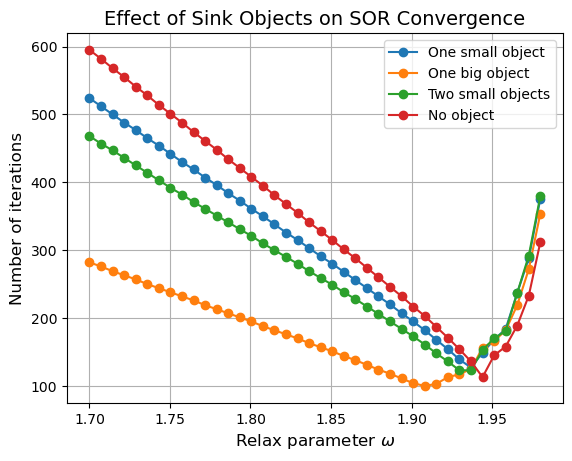

In [11]:
plt.plot(w_list,i_list_smallobject,marker='o',label = 'One small object')
plt.plot(w_list,i_list_bigobject,marker='o',label = 'One big object')
plt.plot(w_list,i_list_2smallobjects,marker='o',label = 'Two small objects')
#plt.plot(w_list,i_list_2bigobjects,label = 'Two big object')
plt.plot(w_list,i_noobject,marker='o',label = 'No object')
plt.legend()
#plt.yscale('log')
plt.ylabel('Number of iterations',size = 12)
plt.xlabel('Relax parameter $\omega$',size = 12)
plt.grid(True)
plt.title('Effect of Sink Objects on SOR Convergence',size = 14)
plt.savefig("SOR_convergence_sinkobjects.png", dpi=300)
plt.show()

In [12]:
min_index_small = i_list_smallobject.index(min(i_list_smallobject))
min_value_small = min(i_list_smallobject)
w_value_small = w_list[min_index_small]

min_index_2small = i_list_2smallobjects.index(min(i_list_2smallobjects))
min_value_2small = min(i_list_2smallobjects)
w_value_2small = w_list[min_index_2small]

min_index_no = i_noobject.index(min(i_noobject))
min_value_no = min(i_noobject)
w_value_no = w_list[min_index_no]

min_index_big = i_list_bigobject.index(min(i_list_bigobject,))
min_value_big = min(i_list_bigobject,)
w_value_big = w_list[min_index_big]

print('For one small object the lowest iteration is', min_value_no, 'At w =', w_value_no)
print(np.mean(i_noobject))
print('For one small object the lowest iteration is', min_value_small, 'At w =', w_value_small)
print(np.mean(i_list_smallobject))
print('For one small object the lowest iteration is', min_value_2small, 'At w =', w_value_2small)
print(np.mean(i_list_2smallobjects))
print('For one small object the lowest iteration is', min_value_big, 'At w =', w_value_big)
print(np.mean(i_list_bigobject))

For one small object the lowest iteration is 113 At w = 1.9441025641025642
345.5
For one small object the lowest iteration is 127 At w = 1.936923076923077
315.725
For one small object the lowest iteration is 123 At w = 1.9297435897435897
285.05
For one small object the lowest iteration is 100 At w = 1.9082051282051282
188.4
